In [1]:
import networkx as nx
import matplotlib.pyplot as plt
import collections
import matplotlib.animation as animation

In [2]:
# undirected graph with 22 nodes
graph = {
    'A': {'B', 'C', 'D'},
    'B': {'A', 'E', 'F'},
    'C': {'A', 'G', 'H'},
    'D': {'A', 'I'},
    'E': {'B', 'J'},
    'F': {'B', 'J', 'K'},
    'G': {'C', 'L'},
    'H': {'C', 'M'},
    'I': {'D', 'N'},
    'J': {'E', 'F', 'O'},
    'K': {'F', 'P'},
    'L': {'G', 'Q'},
    'M': {'H', 'R'},
    'N': {'I', 'S'},
    'O': {'J', 'T'},
    'P': {'K', 'U'},
    'Q': {'L', 'R'},
    'R': {'M', 'Q', 'V'},
    'S': {'N', 'T'},
    'T': {'O', 'S', 'U'},
    'U': {'P', 'T', 'V'},
    'V': {'R', 'U'}
}

In [3]:
G = nx.Graph(graph) # converting graph in dictionary format to a networkx graph

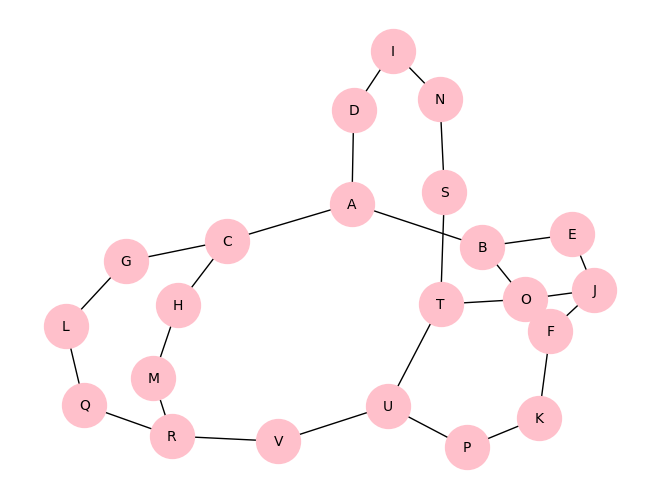

In [4]:
# draw graph function
def draw_graph(G):
    pos = nx.spring_layout(G,seed=0)
    nx.draw(G, pos, with_labels=True, node_color='pink', node_size=1000, font_size=10)
    plt.show()

draw_graph(G)

In [5]:
# BFS
def bfs (graph, start_node):
    visited, queue = set(), collections.deque([start_node])
    visited.add(start_node)
    order =[]
    print(f'Starting BFS from node {start_node}')

    while queue:
        node = queue.popleft()
        order.append(node)
        print(f'Visited node {node}')

        for new_node in (graph[node] - visited):
            visited.add(new_node)
            queue.append(new_node)
        
    return order

bfs_nodes = bfs(graph, 'A') # running BFS starting from node A

Starting BFS from node A
Visited node A
Visited node B
Visited node D
Visited node C
Visited node F
Visited node E
Visited node I
Visited node H
Visited node G
Visited node K
Visited node J
Visited node N
Visited node M
Visited node L
Visited node P
Visited node O
Visited node S
Visited node R
Visited node Q
Visited node U
Visited node T
Visited node V


In [6]:
%timeit bfs(graph, 'A')

Starting BFS from node A
Visited node A
Visited node B
Visited node D
Visited node C
Visited node F
Visited node E
Visited node I
Visited node H
Visited node G
Visited node K
Visited node J
Visited node N
Visited node M
Visited node L
Visited node P
Visited node O
Visited node S
Visited node R
Visited node Q
Visited node U
Visited node T
Visited node V
Starting BFS from node A
Visited node A
Visited node B
Visited node D
Visited node C
Visited node F
Visited node E
Visited node I
Visited node H
Visited node G
Visited node K
Visited node J
Visited node N
Visited node M
Visited node L
Visited node P
Visited node O
Visited node S
Visited node R
Visited node Q
Visited node U
Visited node T
Visited node V
Starting BFS from node A
Visited node A
Visited node B
Visited node D
Visited node C
Visited node F
Visited node E
Visited node I
Visited node H
Visited node G
Visited node K
Visited node J
Visited node N
Visited node M
Visited node L
Visited node P
Visited node O
Visited node S
Visited no

In [7]:
# %load_ext memory_profiler
%memit bfs(graph, 'A')

UsageError: Line magic function `%memit` not found.


In [ ]:
import psutil
import os
import time

def memory_usage():
    process = psutil.Process(os.getpid())
    return process.memory_info().rss / (1024 * 1024)  # in MB

mem_before = memory_usage()
start = time.time()

bfs(graph, 'A')

end = time.time()
mem_after = memory_usage()

print(f"Time: {end - start:.5f} sec")
print(f"Memory: {mem_after - mem_before:.5f} MB")


Starting BFS from node A
Visited node A
Visited node D
Visited node B
Visited node C
Visited node I
Visited node F
Visited node E
Visited node G
Visited node H
Visited node N
Visited node J
Visited node K
Visited node L
Visited node M
Visited node S
Visited node O
Visited node P
Visited node Q
Visited node R
Visited node T
Visited node U
Visited node V
Time: 0.00054 sec
Memory: 0.00000 MB


In [ ]:
# random graph generator
def generate_graph(n_nodes, edge_factor=3):
    G = nx.gnm_random_graph(n_nodes, n_nodes * edge_factor)
    graph = {str(node): set(map(str, G.neighbors(node))) for node in G.nodes}
    return graph

In [ ]:
def measure_bfs(graph, start_node='0'):
    process = psutil.Process(os.getpid())

    mem_before = process.memory_info().rss / (1024 * 1024)  # in MB
    start = time.time()

    bfs(graph, start_node)

    end = time.time()
    mem_after = process.memory_info().rss / (1024 * 1024)  # in MB

    return (end - start), (mem_after - mem_before)


In [ ]:
# generating graphs with increasing number of nodes/size
node_sizes = [500, 1000, 2000, 4000, 8000]
times = []
memories = []

for size in node_sizes:
    print(f"Running for {size} nodes...")
    g = generate_graph(size)
    t, m = measure_bfs(g)
    times.append(t)
    memories.append(m)


Running for 500 nodes...
Starting BFS from node 0
Visited node 0
Visited node 68
Visited node 133
Visited node 86
Visited node 235
Visited node 468
Visited node 222
Visited node 238
Visited node 342
Visited node 3
Visited node 7
Visited node 299
Visited node 383
Visited node 497
Visited node 498
Visited node 456
Visited node 420
Visited node 12
Visited node 395
Visited node 44
Visited node 30
Visited node 436
Visited node 247
Visited node 345
Visited node 357
Visited node 20
Visited node 107
Visited node 481
Visited node 438
Visited node 109
Visited node 185
Visited node 371
Visited node 429
Visited node 385
Visited node 124
Visited node 144
Visited node 314
Visited node 435
Visited node 112
Visited node 22
Visited node 280
Visited node 418
Visited node 427
Visited node 452
Visited node 108
Visited node 120
Visited node 335
Visited node 476
Visited node 381
Visited node 24
Visited node 453
Visited node 344
Visited node 461
Visited node 239
Visited node 212
Visited node 258
Visited node

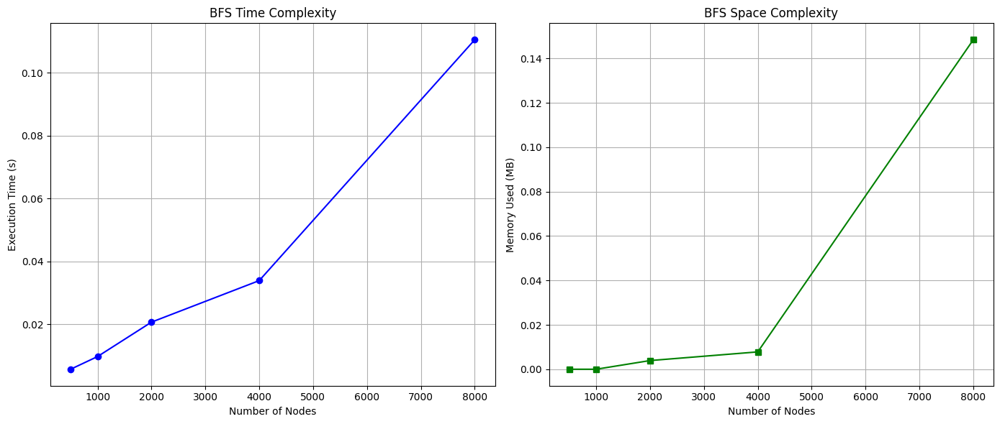

In [ ]:
# plotting time complexity and space complexity
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Time Complexity
axs[0].plot(node_sizes, times, marker='o', color='blue')
axs[0].set_title('BFS Time Complexity')
axs[0].set_xlabel('Number of Nodes')
axs[0].set_ylabel('Execution Time (s)')
axs[0].grid(True)

# Space Complexity
axs[1].plot(node_sizes, memories, marker='s', color='green')
axs[1].set_title('BFS Space Complexity')
axs[1].set_xlabel('Number of Nodes')
axs[1].set_ylabel('Memory Used (MB)')
axs[1].grid(True)

plt.tight_layout()
plt.show()


/Users/anveshantimsina/Desktop/Stuff/projects/dfs-bfs-ucs/venv/lib/python3.12/site-packages/matplotlib/animation.py:908: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


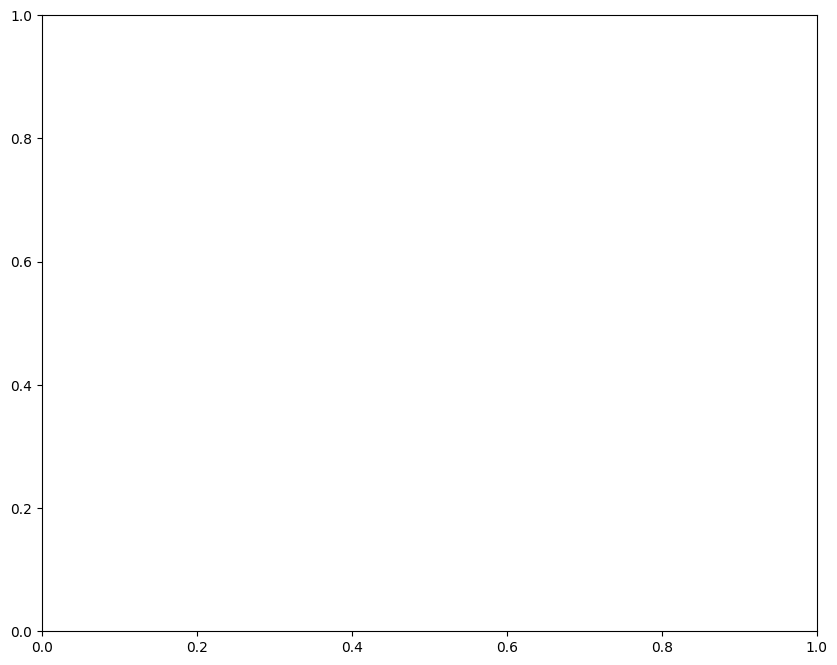

In [ ]:
fig, ax = plt.subplots(figsize=(10,8))
# ax.set_axis_off()
pos = nx.spring_layout(G, seed=0)

def update(i):
    ax.clear()
    visited_so_far = bfs_nodes[:i+1]
    node_colors = ['red' if node in visited_so_far else 'lightgray' for node in G.nodes()]
    nx.draw(G, pos, with_labels=True, node_color=node_colors, ax=ax, node_size=1000, font_weight='bold')
    ax.set_title(f'BFS Traversal: Step {i+1}/{len(bfs_nodes)}', fontsize = 16)

anim = animation.FuncAnimation(fig, update, frames=len(bfs_nodes), interval= 1000, repeat=False)
plt.show()